# 1.- Comprensión de los Datos en Bruto
Vamos a realizar un análisis de los datos que contiene nuestro dataset para ver qué tipo de datos tenemos, a qué clases pertenecen, volumen de datos, valores ausentes, etc.

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

In [2]:
# Variables Globales
retraso = 2             # Indica qué diferencia de años se usa para los cálculos diferenciales
tiempo_prediccion = 2   # Indica con cuantos años de antelación queremos predecir una posible crisis
tiempo_recesion = 4     # Indica cuantos años se consideran como post-crisis y serán eliminados junto
                        # a los años de crisis para evitar sesgo en los datos

## 1.1- Características generales

In [3]:
# Cqrgamos nuestro dataset
data = pd.read_csv('../datasets/JSTdatasetR6.csv', sep=';', na_values='', decimal=',')

# Modificación de parámetros de visualización para que dado que el número de columnas es grande se muestren todas a la vez
pd.set_option('display.max_columns', 100)
pd.set_option('display.max_rows', 500)

# Revisamos la tipología de los datos
print('Tipología de atributos:')
display(data.dtypes)

# Revisamos las características de los mismos
print('\n\nCaracteristicas de atributos:')
display(data.describe(include='all'))
display(data.info(show_counts=True))

# Revisamos el número de instancias y atributos
print(f'\n\nVolumetría de datos:\nNúmero de Instancias: {data.shape[0]}\nNúmero de Atributos: {data.shape[1]-1}\n\n')
# Revisamos el número total de países
print(f'Número Total de Países: {len(np.unique(data["iso"]))}')

# Revisamos el número total de años y sus valores
print(f'Número Total de Años: {len(np.unique(data["year"]))}')
print(f'{np.unique(data["year"])}\n\n')

# Mostramos una muestra de los registros
print('Muestra de datos:')
display(data.sample(5))

Tipología de atributos:


year                          int64
country                      object
iso                          object
ifs                           int64
pop                         float64
rgdpmad                     float64
rgdpbarro                   float64
rconsbarro                  float64
gdp                         float64
iy                          float64
cpi                         float64
ca                          float64
imports                     float64
exports                     float64
narrowm                     float64
money                       float64
stir                        float64
ltrate                      float64
hpnom                       float64
unemp                       float64
wage                        float64
debtgdp                     float64
revenue                     float64
expenditure                 float64
xrusd                       float64
tloans                      float64
tmort                       float64
thh                         



Caracteristicas de atributos:


,year,country,iso,ifs,pop,rgdpmad,rgdpbarro,rconsbarro,gdp,iy,cpi,ca,imports,exports,narrowm,money,stir,ltrate,hpnom,unemp,wage,debtgdp,revenue,expenditure,xrusd,tloans,tmort,thh,tbus,bdebt,lev,ltd,noncore,crisisJST,crisisJST_old,peg,peg_strict,peg_type,peg_base,JSTtrilemmaIV,eq_tr,housing_tr,bond_tr,bill_rate,rent_ipolated,housing_capgain_ipolated,housing_capgain,housing_rent_rtn,housing_rent_yd,eq_capgain,eq_dp,eq_capgain_interp,eq_tr_interp,eq_dp_interp,bond_rate,eq_div_rtn,capital_tr,risky_tr,safe_tr
count,2718.00000,2718,2718,2718.000000,2667.000000,2666.000000,2664.000000,2561.000000,2.641000e+03,2425.000000,2.666000e+03,2.489000e+03,2.603000e+03,2.603000e+03,2.604000e+03,2.518000e+03,2520.000000,2630.000000,2.050000e+03,1949.000000,2.630000e+03,2489.000000,2.542000e+03,2.561000e+03,2.665000e+03,2.465000e+03,2.312000e+03,1.374000e+03,1.299000e+03,1.865000e+03,2353.000000,2299.000000,2230.000000,2668.000000,2568.000000,2668.000000,2668.000000,2668,2465,2073.000000,2.263000e+03,1909.000000,2295.000000,2351.000000,29.0,5.0,2045.000000,1909.000000,1921.000000,2.170000e+03,2169.000000,7.0,7.0,6.0,2381.000000,2163.000000,1830.000000,1854.000000,2247.000000
unique,NaN,18,18,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3,4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
top,NaN,Australia,AUS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PEG,GBR,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
freq,NaN,151,151,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1582,763,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,1945.00000,NaN,NaN,148.333333,31439.397574,9155.064763,39.793748,42.133609,2.454826e+06,0.188838,4.191118e+01,-4.572271e+04,8.097705e+05,7.925207e+05,1.178995e+06,2.404282e+06,4.677768,5.448643,6.695866e+01,5.484313,4.502840e+01,0.542791,5.041672e+05,5.786972e+05,4.900665e+01,2.879901e+06,1.349183e+06,2.452142e+06,2.862759e+06,3.476208e+06,10.032621,95.857216,36.403978,0.032984,0.035047,0.621439,0.526237,NaN,NaN,-0.002851,1.166184e+06,0.107842,0.059423,0.043779,1.0,1.0,0.060921,0.054374,0.051950,1.167935e+06,0.040949,1.0,1.0,1.0,0.054346,0.042763,0.099308,0.111523,0.051634
std,43.59701,NaN,NaN,24.165940,45898.993728,7976.190143,33.884462,32.274402,1.615548e+07,0.064621,5.689962e+01,7.670287e+05,4.947326e+06,4.956606e+06,1.077840e+07,1.645903e+07,3.332995,3.157725,1.061554e+02,4.081174,7.226900e+01,0.392740,2.952977e+06,3.457500e+06,2.097611e+02,2.143628e+07,1.123262e+07,1.353124e+07,1.550962e+07,2.011087e+07,7.194283,32.326892,19.883801,0.178627,0.183934,0.485119,0.499405,NaN,NaN,0.783131,5.547655e+07,0.104737,0.084800,0.030672,0.0,0.0,0.148323,0.020643,0.020006,5.440622e+07,0.017111,0.0,0.0,0.0,0.031442,0.017694,0.090360,0.110373,0.048357
min,1870.00000,NaN,NaN,111.000000,1675.000000,737.375497,3.263085,4.074400,1.250757e-11,0.017287,1.150362e-11,-1.687900e+07,2.803000e-12,2.278000e-12,1.084000e-12,2.919525e-12,-2.000000,-0.525000,3.014026e-12,0.035923,8.320876e-13,0.019074,5.304000e-13,5.040000e-13,3.610507e-12,3.052196e-12,2.969000e-12,5.540000e-03,2.136998e-01,2.879401e-12,0.848073,11.146478,1.525077,0.000000,0.000000,0.000000,0.000000,NaN,NaN,-3.510000,-8.841469e-01,-0.260873,-0.324742,-0.020000,1.0,1.0,-0.312501,0.004855,0.004855,-8.842261e-01,0.000000,1.0,1.0,1.0,-0.035316,0.000000,-0.232140,-0.238515,-0.152371
25%,1907.00000,NaN,NaN,132.000000,4866.650000,2873.047663,12.694448,15.650000,5.428200e+01,0.140980,2.526395e+00,-6.345947e+01,5.029000e+00,5.110800e+00,9.363653e+00,1.630303e+01,2.627500,3.587708,2.423478e+00,2.300000,4.557921e-01,0.253000,6.933250e+00,6.895100e+00,1.000000e+00,2.123700e+01,8.287246e+00,2.617783e+02,2.907489e+02,1.706697e+02,4.

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2718 entries, 0 to 2717
Data columns (total 59 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   year                      2718 non-null   int64  
 1   country                   2718 non-null   object 
 2   iso                       2718 non-null   object 
 3   ifs                       2718 non-null   int64  
 4   pop                       2667 non-null   float64
 5   rgdpmad                   2666 non-null   float64
 6   rgdpbarro                 2664 non-null   float64
 7   rconsbarro                2561 non-null   float64
 8   gdp                       2641 non-null   float64
 9   iy                        2425 non-null   float64
 10  cpi                       2666 non-null   float64
 11  ca                        2489 non-null   float64
 12  imports                   2603 non-null   float64
 13  exports                   2603 non-null   float64
 14  narrowm 

None



Volumetría de datos:
Número de Instancias: 2718
Número de Atributos: 58


Número Total de Países: 18
Número Total de Años: 151
[1870 1871 1872 1873 1874 1875 1876 1877 1878 1879 1880 1881 1882 1883
 1884 1885 1886 1887 1888 1889 1890 1891 1892 1893 1894 1895 1896 1897
 1898 1899 1900 1901 1902 1903 1904 1905 1906 1907 1908 1909 1910 1911
 1912 1913 1914 1915 1916 1917 1918 1919 1920 1921 1922 1923 1924 1925
 1926 1927 1928 1929 1930 1931 1932 1933 1934 1935 1936 1937 1938 1939
 1940 1941 1942 1943 1944 1945 1946 1947 1948 1949 1950 1951 1952 1953
 1954 1955 1956 1957 1958 1959 1960 1961 1962 1963 1964 1965 1966 1967
 1968 1969 1970 1971 1972 1973 1974 1975 1976 1977 1978 1979 1980 1981
 1982 1983 1984 1985 1986 1987 1988 1989 1990 1991 1992 1993 1994 1995
 1996 1997 1998 1999 2000 2001 2002 2003 2004 2005 2006 2007 2008 2009
 2010 2011 2012 2013 2014 2015 2016 2017 2018 2019 2020]


Muestra de datos:


,year,country,iso,ifs,pop,rgdpmad,rgdpbarro,rconsbarro,gdp,iy,cpi,ca,imports,exports,narrowm,money,stir,ltrate,hpnom,unemp,wage,debtgdp,revenue,expenditure,xrusd,tloans,tmort,thh,tbus,bdebt,lev,ltd,noncore,crisisJST,crisisJST_old,peg,peg_strict,peg_type,peg_base,JSTtrilemmaIV,eq_tr,housing_tr,bond_tr,bill_rate,rent_ipolated,housing_capgain_ipolated,housing_capgain,housing_rent_rtn,housing_rent_yd,eq_capgain,eq_dp,eq_capgain_interp,eq_tr_interp,eq_dp_interp,bond_rate,eq_div_rtn,capital_tr,risky_tr,safe_tr
850,1965,Denmark,DNK,128,4758.100,10953.321704,49.580845,58.29000,6.970000e+01,0.216887,15.992030,-1.265524e+00,1.949700e+01,1.602300e+01,1.495350e+01,2.749980e+01,7.000000,7.3500,15.918400,0.710413,9.277537,0.129151,1.447700e+01,1.466100e+01,6.8910,5.905400e+01,29.527,2.360000e+01,3.545400e+01,4.189449e+01,8.083526,88.126709,25.132959,0.0,0.0,1.0,1.0,PEG,USA,0.42750,0.071166,0.114394,-0.036184,0.070000,NaN,NaN,0.065717,0.048678,0.045676,0.026316,0.043700,NaN,NaN,NaN,0.073500,0.044850,0.102007,0.110235,0.016908
1025,1989,Spain,ESP,184,38821.377,11518.814845,67.033316,69.49876,4.782945e+07,0.245502,93.702224,-1.293221e+06,1.008441e+07,8.214756e+06,1.186000e+07,4.089660e+07,14.391667,13.7025,86.510456,17.331100,91.911469,0.397256,9.847000e+06,1.095100e+07,109.7200,3.261526e+07,7795298.000,8.685042e+06,2.393021e+07,2.965023e+07,6.752131,87.640587,46.823151,0.0,0.0,1.0,0.0,PEG,DEU,1.93500,0.126304,0.261566,0.102260,0.143917,NaN,NaN,0.232998,0.028568,0.023170,0.086415,0.036716,NaN,NaN,NaN,0.137025,0.039889,0.231870,0.248013,0.123088
2505,1959,Sweden,SWE,144,7446.000,8287.930166,36.114757,46.20000,6.624500e+04,0.218462,12.878788,5.181000e+00,1.248700e+04,1.142000e+04,6.193208e+03,4.690533e+04,4.500000,4.2825,8.356111,2.000000,5.356020,0.281305,1.260455e+04,1.407355e+04,5.1810,2.776000e+04,19041.000,NaN,NaN,NaN,7.334686,68.712242,11.833523,0.0,0.0,1.0,1.0,PEG,USA,1.08125,0.482974,0.119665,0.038520,0.045000,NaN,NaN,0.033816,0.085849,0.083040,0.430603,0.029400,NaN,NaN,NaN,0.042825,0.042060,0.162909,0.189989,0.041760
824,1939,Denmark,DNK,128,3805.000,5992.951380,26.964017,38.15000,8.127000e+00,0.193060,5.147182,8.800000e-02,1.740000e+00,1.578000e+00,7.140000e-01,3.832868e+00,4.642500,4.6250,2.388943,5.132724,1.391630,0.153008,NaN,8.580000e-01,4.9149,9.964650e+00,5.510,NaN,NaN,5.686034e+00,12.896629,81.950401,11.382690,0.0,0.0,0.0,0.0,FLOAT,HYBRID,NaN,0.081447,0.098617,-0.012887,0.046425,NaN,NaN,0.015076,0.083541,0.082300,0.020619,0.059600,NaN,NaN,NaN,0.046250,0.060829,0.084767,0.095445,0.016769
2503,1957,Sweden,SWE,144,7364.000,8092.425107,33.832654,43.99000,5.896300e+04,0.201855,12.252964,-1.478400e+02,1.256600e+04,1.106100e+04,5.813088e+03,3.854473e+04,4.500000,4.3300,7.809449,1.900000,4.874753,0.275418,1.069121e+04,1.180455e+04,5.2800,2.252200e+04,15216.000,NaN,NaN,NaN,8.739226,74.602898,10.607509,0.0,0.0,1.0,1.0,PEG,USA,0.04750,0.084471,0.344995,0.022830,0.046000,NaN,NaN,0.244094,0.100902,0.081104,0.040222,0.047800,NaN,NaN,NaN,0.043300,0.049723,0.254481,0.307259,0.034415


In [4]:
# Revisamos la distribución de los valores ausentes
num_ausentes = data.isna().sum()
porcentaje = round(num_ausentes / data.shape[0] * 100, 2)
porcentaje.sort_values(ascending=False, inplace=True)
porcentaje_med = round(np.sum(porcentaje) / porcentaje.shape[0], 2)
print(f'Porcentaje Medio de Valores Ausentes: {porcentaje_med}%\n')
print('Porcentaje de Valores Ausentes por Columna')
print(porcentaje)

Porcentaje Medio de Valores Ausentes: 20.46%

Porcentaje de Valores Ausentes por Columna
housing_capgain_ipolated    99.82
eq_dp_interp                99.78
eq_tr_interp                99.74
eq_capgain_interp           99.74
rent_ipolated               98.93
tbus                        52.21
thh                         49.45
capital_tr                  32.67
risky_tr                    31.79
bdebt                       31.38
housing_rent_rtn            29.76
housing_tr                  29.76
housing_rent_yd             29.32
unemp                       28.29
housing_capgain             24.76
hpnom                       24.58
JSTtrilemmaIV               23.73
eq_div_rtn                  20.42
eq_dp                       20.20
eq_capgain                  20.16
noncore                     17.95
safe_tr                     17.33
eq_tr                       16.74
bond_tr                     15.56
ltd                         15.42
tmort                       14.94
bill_rate                  

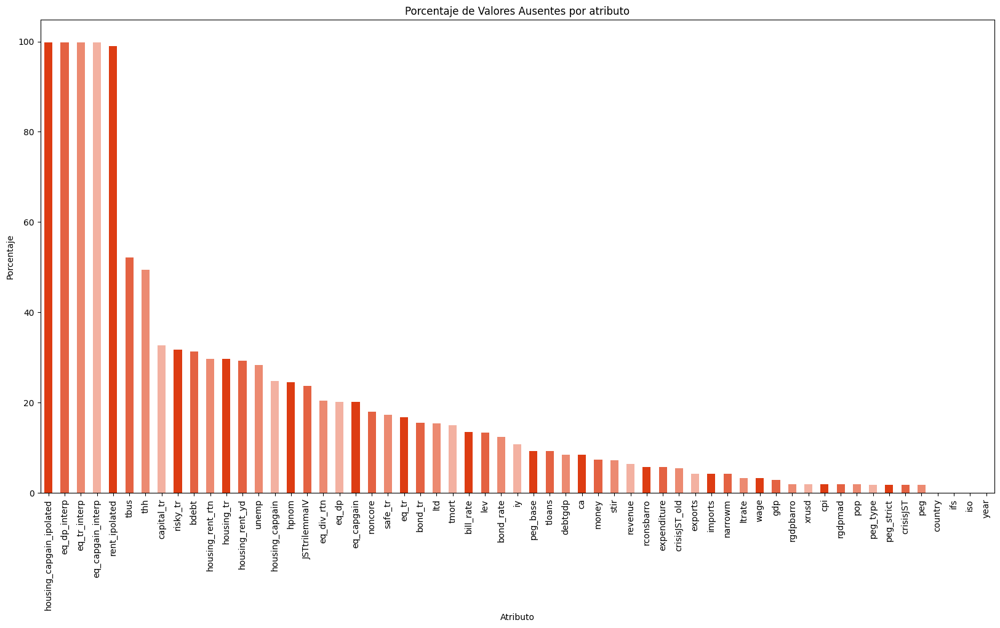

In [5]:
# Establecemos la paleta de colores de VIU
viu_colors = ['#dd3c12', '#e46242', '#ec8a71', '#f3b1a1',
              '#dd3c12', '#e46242', '#ec8a71', '#f3b1a1',
              '#dd3c12', '#e46242', '#ec8a71']

etiquetas = ['No Crisis', 'Crisis']

porcentaje.plot(kind="bar", figsize=(20,10), color=viu_colors).set(title='Porcentaje de Valores Ausentes por atributo')
plt.xlabel('Atributo')
plt.ylabel('Porcentaje')
plt.xticks(rotation=90)
plt.savefig('../app/graficas/comprension_bruto_ausentes_atributo.png', bbox_inches='tight')
plt.show()

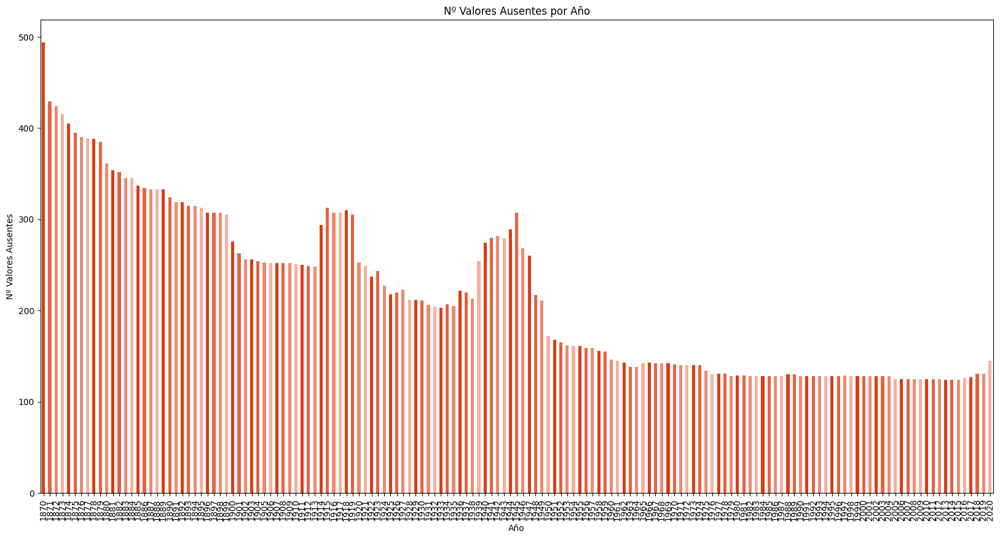

In [6]:
agrupacion = data.groupby('year').apply(lambda x: (x.isnull().sum(axis=1)).sum())

agrupacion.plot(kind="bar", stacked=True, rot=90, figsize=(20,10), xlabel='Año', title='Nº Valores Ausentes por Año',
             color=viu_colors)
plt.ylabel('Nº Valores Ausentes')
plt.savefig('../app/graficas/comprension_bruto_ausentes_anio.png', bbox_inches='tight')
plt.show()

Como se puede observar hay atributos con un número elevado de valores ausentes. Antes de continuar y para ver si todas las instancias del dataset serán útiles, vamos a revisar la distribución temporal de dichos valores ausentes.

Estableceremos como primer criterio de filtrado, que únicamente se utilizará la información correspondiente a las instancias con un número total de valores ausentes inferior al 25% del total del número de atributos. De manera adicional, se usará únicamente la serie temporal contigua con un número de instancias útiles superior también al 25% del número total de países por año, es decir, sólo se usarán los años contiguos en los que todos garanticen los dos criterios anteriores:

In [7]:
# Obtenemos el número de muestras de países por año para el primer criterio
# (número total de valores ausentes inferior al 30%)

th_atributos = data.shape[1]*30/100
datos_agrupados = data.groupby('year').apply(lambda x: (x.isnull().sum(axis=1) > th_atributos).sum())
print(pd.Series(datos_agrupados, name='Muestras Inválidas'))

# Calculamos la serie de años final que cumple tanto el primer criterio como el segundo:
th_anios = len(np.unique(data["iso"]))*30/100
ultimo_anio_no_util = datos_agrupados[::-1].gt(th_anios).idxmax()
print(f'Años útiles: {np.unique(data[data["year"]>ultimo_anio_no_util]["year"])}')

year
1870    18
1871    13
1872    14
1873    14
1874    14
1875    13
1876    13
1877    13
1878    13
1879    13
1880    11
1881    11
1882    11
1883    11
1884    11
1885    10
1886    10
1887    10
1888    10
1889    10
1890     9
1891     9
1892     9
1893     8
1894     8
1895     8
1896     8
1897     8
1898     8
1899     8
1900     4
1901     4
1902     4
1903     4
1904     4
1905     4
1906     4
1907     4
1908     4
1909     4
1910     4
1911     4
1912     4
1913     3
1914     4
1915     7
1916     7
1917     7
1918     7
1919     7
1920     4
1921     4
1922     3
1923     3
1924     3
1925     2
1926     2
1927     2
1928     2
1929     2
1930     2
1931     2
1932     2
1933     2
1934     2
1935     2
1936     3
1937     3
1938     3
1939     4
1940     5
1941     4
1942     5
1943     5
1944     5
1945     7
1946     5
1947     5
1948     3
1949     3
1950     2
1951     2
1952     2
1953     2
1954     2
1955     2
1956     2
1957     2
1958     2
1959     2
1960 

Eliminamos las instancias no útiles y revisamos las volumetrías finales:

In [8]:
data.drop(data[data['year'] <= ultimo_anio_no_util-retraso].index, inplace=True)
data = data.reset_index(drop=True)

In [9]:
# Revisamos el número de instancias y atributos
print(f'\n\nVolumetría de datos:\nNúmero de Instancias: {data.shape[0]}\nNúmero de Atributos: {data.shape[1]-1}\n\n')
# Revisamos el número total de países
print(f'Número Total de Países: {len(np.unique(data["iso"]))}')

# Revisamos el número total de años y sus valores
print(f'Número Total de Años: {len(np.unique(data["year"]))}')
print(f'{np.unique(data["year"])}\n\n')

clases, ocurrencias = np.unique(data['crisisJST'], return_counts=True)
porcentajes = np.round(ocurrencias / data.shape[0] * 100, 2)
print(f'Clases: {clases}\nEtiquetas {etiquetas}\nOcurrencias: {ocurrencias}\nPorcentajes {porcentajes}')




Volumetría de datos:
Número de Instancias: 1386
Número de Atributos: 58


Número Total de Países: 18
Número Total de Años: 77
[1944 1945 1946 1947 1948 1949 1950 1951 1952 1953 1954 1955 1956 1957
 1958 1959 1960 1961 1962 1963 1964 1965 1966 1967 1968 1969 1970 1971
 1972 1973 1974 1975 1976 1977 1978 1979 1980 1981 1982 1983 1984 1985
 1986 1987 1988 1989 1990 1991 1992 1993 1994 1995 1996 1997 1998 1999
 2000 2001 2002 2003 2004 2005 2006 2007 2008 2009 2010 2011 2012 2013
 2014 2015 2016 2017 2018 2019 2020]


Clases: [0. 1.]
Etiquetas ['No Crisis', 'Crisis']
Ocurrencias: [1361   25]
Porcentajes [98.2  1.8]


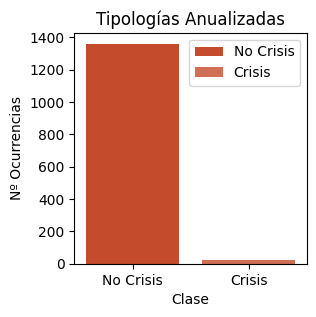

In [10]:
fig,ax = plt.subplots(figsize=(3,3))
ax = sns.countplot(data, x='crisisJST', palette=sns.color_palette(viu_colors,2)).set(title='Tipologías Anualizadas')
plt.xlabel('Clase')
plt.ylabel('Nº Ocurrencias')
plt.xticks(ticks=[0,1],labels=etiquetas)
plt.legend(etiquetas)
plt.savefig('../app/graficas/comprension_bruto_instancias_clase.png', bbox_inches='tight')
plt.show()

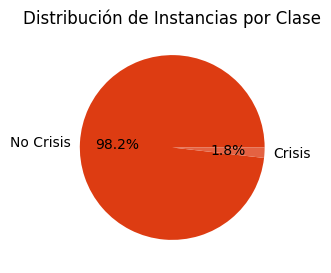

In [11]:
fig,ax = plt.subplots(figsize=(3,3))
aggregates = data['crisisJST'].value_counts()
plt.pie(aggregates, labels = etiquetas, colors=sns.color_palette(viu_colors, 2), autopct='%.1f%%')
plt.title('Distribución de Instancias por Clase')
plt.savefig('../app/graficas/comprension_bruto_porcentaje_clase.png', bbox_inches='tight')
plt.show()

## Conclusiones Previas
Como puntos a descatar sobre nuestro dataset:
* Existe un acusado desbalance de instancias asociadas a cada clase
* El volumen de valores ausentes era elevado en algunos atributos y hemos tenido que realizar un primer filtrado de datos brutos útiles.
* Debemos trabajar con datos asociados a series temporales.

# 2.- Preparación de Dataset
A partir de los datos anteriores se procede a la elaboración de los siguientes nuevos atributos que serán los finalmente usados como base para el proceso de entrenamiento:
+ Diferencial relativo del Índice de Precios al Consumo.
+ Diferencial absoluto del Agregado Monetario Amplio (M3) escalado por el Producto Interior Bruto del país.
+ Diferencial relativo del Consumo Real per Cápita.
+ Diferencial absoluto del volumen de Deuda Pública escalado por el Producto Interior Bruto.
+ Diferencial absoluto del volumen de Inversión escalado por el Producto Interior Bruto.
+ Diferencial absoluto del estado de Cuenta Corriente del país escalado por el Producto Interior Bruto.
+ Diferencial absoluto del Volumen de Crédito al sector privado escalado por el Producto Interior Bruto.
+ Diferencial absoluto del ratio Volumen de Crédito al sector privado - Tipo de Interés a largo plazo.
+ Aumento de Crédito Global.
+ Curva de Rendimiento Global (Global Yield Curve).
+ Ratio Tipos de Interes a Largo Plazo vs Corto Plazo.

In [12]:
# Funciones auxiliares

def crear_atributos_escalados_pib(data, atributos):
    # Escalamos los atributos de entrada dividiendo su valor por el 'Gross Domestic Product'
    atributos_escalados = []
    for atributo in atributos:
        nombre = f'{atributo}_pib'
        data[nombre] = data[atributo] / data['gdp']
        atributos_escalados.append(nombre)
    return data, atributos_escalados


def calcula_atributos_diferenciales(data, atributos, tipo, retraso=2):
    # Variables calculadas como el diferencial absoluto o porcentual entre el 
    # valor actual de la variable y el asociado 'retraso' años atrás
    for atributo in atributos:
        if tipo == 'absoluto': # Diferencial Absoluto
            nombre = f'{atributo}_dif_abs{retraso}'
            data[nombre] = data.groupby('iso', group_keys=False)[atributo].diff(retraso)
        else: # Diferencial Porcentual
            nombre = f'{atributo}_dif_por{retraso}'
            data[nombre] = data.groupby('iso', group_keys=False)[atributo].apply(lambda x: cambio_relativo_historico(x, retraso))
    return data


def cambio_relativo_historico(atributo, retraso):
    # Calcula el cambio relativo para un atributo entre dos fechas 
    atributo_historico = np.array(atributo.shift(retraso))
    return (atributo - atributo_historico) / atributo_historico


def marca_pre_post_crisis(data):
    # Buscamos los años de crisis
    posiciones = data[data['crisisJST'] == 1].index
    data[data['crisisJST'] == 1].to_csv('../datasets/finales/test3.csv', sep=';', na_rep='', decimal=',', index=False)
    aux = data['crisisJST'].copy()
    for posicion in posiciones:
        # Cambiamos la clase de las intancias de crisis para borrarlas posteriormente
        aux[posicion] = 2

        # Marcamos las instancias post-crisis (importante comprobar límites de dataframe y que se mantiene
        # el mismo país)
        for j in range(posicion + 1, posicion + tiempo_recesion + 1):
            if not j >= data.shape[0]:
                if data['iso'][j] == data['iso'][posicion]:
                    aux[j] = 2
        # Marcamos las instancias pre-crisis (importante comprobar límites de dataframe y que se mantiene
        # el mismo país)
        for j in range(posicion - 1, posicion - tiempo_prediccion - 1, -1):
            if not j < 0:
                if data['iso'][j] == data['iso'][posicion]:
                    aux[j] = 1
    data['crisisJST'] = aux
    return data

def aumento_credito_global(data):
    for year in data['year'].unique():
        for country in data['iso'].unique():
                # El calculo se realiza para cada año teniendo en cuenta todos
                # los países menos el actual
            perc_pos = data.loc[(data['year']==year) & (data.iso != country), 'tloans_pib_dif_abs' + str(retraso)].mean()
            if not np.isnan(perc_pos):
                data.loc[(data['year']==year) & (data.iso == country), 'global_loan' + str(retraso)] = perc_pos
    return data


def pendiente_curva_yield_global(data):
    for year in data["year"].unique():
        for country in data["iso"].unique():
                # El calculo se realiza para cada año teniendo en cuenta todos
                # los países menos el actual
            perc_pos = data.loc[(data['year']==year) & (data.iso != country), "drate"].mean()
            if not np.isnan(perc_pos):
                data.loc[(data['year']==year) & (data.iso == country), "global_drate"] = perc_pos
    return data


def crear_dataset(df):
    # Creación del dataset de trabajo a partir de los datos en bruto
    data = df.copy()

    # Cálculo de atributos finales
    data.loc[:, 'drate'] = data['ltrate'] - data['stir']  # Rate Diferencial
    data.loc[:, 'pdebt'] = data['debtgdp'] * data['gdp']  # Deuda Pública neta
    data.loc[:, 'inv'] = data['iy'] * data['gdp']         # Inversión neta
    data.loc[:, 'tdbtserv'] = data['tloans'] * data['ltrate'] / 100.0    # Ratio Volumen de Crédito al sector privado - Tipo de Interés a largo plazo

        # Atributos a escalar por el PIB del país (GDP)
    atributos_escalar = ['money', 'narrowm', 'tloans', 'tbus',
                          'thh', 'tmort', 'ca', 'cpi', 'tdbtserv',
                          'inv', 'pdebt']
    
    data, atributos_escalados_pib = crear_atributos_escalados_pib(data, atributos_escalar)
    
        # Atributos calculados por diferenciales entre años

            # Diferencias absolutas    
    data = calcula_atributos_diferenciales(data, ['ltrate', 'stir', 'drate'] + atributos_escalados_pib, 'absoluto', retraso)

            # Diferencias relativas
    data = calcula_atributos_diferenciales(data, ['hpnom', 'rconsbarro', 'gdp'] + atributos_escalar, 'porcentaje', retraso=retraso)
    
        # Atributos calculados mediante indicadores globales

    data = aumento_credito_global(data)
    
    data = pendiente_curva_yield_global(data)

    # Marcado de años precrisis, post-crisis
    
    data = marca_pre_post_crisis(data)
    
    # Nos quedamos sólo con las columnas necesarias
    atributos_finales = ['cpi_dif_por2', 'money_pib_dif_abs2', 'rconsbarro_dif_por2',
                         'pdebt_pib_dif_abs2', 'inv_pib_dif_abs2', 'ca_pib_dif_abs2',
                         'tloans_pib_dif_abs2', 'tdbtserv_pib_dif_abs2', 'global_loan2',
                         'global_drate', 'drate']

    data = pd.concat([data.loc[:, atributos_finales], data['year'], data['iso'], data['crisisJST']], axis=1)

    # Eliminamos los años de crisis y post-crisis para evitar sesgo en los datos
    data.drop(data[data.crisisJST == 2].index, inplace=True)

    data.drop(data[data['year'] <= ultimo_anio_no_util].index, inplace=True)
    
    # Ordenamos el dataset por año y país para facilitar posteriormente el particionado
    # evitando el leak de datos temporales entre entrenamiento y test
    data.sort_values(by=['year', 'iso'], inplace=True)
        
    data = data.reset_index(drop=True)  # update index
    return data

In [13]:
# Creamos el dataset de trabajo
data = crear_dataset(data)
print(data['year'].unique())

[1946 1947 1948 1949 1950 1951 1952 1953 1954 1955 1956 1957 1958 1959
 1960 1961 1962 1963 1964 1965 1966 1967 1968 1969 1970 1971 1972 1973
 1974 1975 1976 1977 1978 1979 1980 1981 1982 1983 1984 1985 1986 1987
 1988 1989 1990 1991 1992 1993 1994 1995 1996 1997 1998 1999 2000 2001
 2002 2003 2004 2005 2006 2007 2008 2009 2010 2011 2012 2013 2014 2015
 2016 2017 2018 2019 2020]


# Análisis de datos
Vamos a revisar las características del dataset de trabajo final

In [14]:
# Revisamos la tipología de los datos
print('Tipología de atributos:')
display(data.dtypes)

# Revisamos las características de los mismos
print('\n\nCaracteristicas de atributos:')
display(data.describe(include='all'))
display(data.info(show_counts=True))

# Revisamos el número de instancias y atributos
print(f'\n\nVolumetría de datos:\nNúmero de Instancias: {data.shape[0]}\nNúmero de Atributos: {data.shape[1]-1}\n\n')
# Revisamos el número total de países
print(f'Número Total de Países: {len(np.unique(data["iso"]))}')

# Revisamos el número total de años y sus valores
print(f'Número Total de Años: {len(np.unique(data["year"]))}')
print(f'{np.unique(data["year"])}\n\n')

# Mostramos una muestra de los registros
print('Muestra de datos:')
display(data.sample(5))

Tipología de atributos:


cpi_dif_por2             float64
money_pib_dif_abs2       float64
rconsbarro_dif_por2      float64
pdebt_pib_dif_abs2       float64
inv_pib_dif_abs2         float64
ca_pib_dif_abs2          float64
tloans_pib_dif_abs2      float64
tdbtserv_pib_dif_abs2    float64
global_loan2             float64
global_drate             float64
drate                    float64
year                       int64
iso                       object
crisisJST                float64
dtype: object



Caracteristicas de atributos:


,cpi_dif_por2,money_pib_dif_abs2,rconsbarro_dif_por2,pdebt_pib_dif_abs2,inv_pib_dif_abs2,ca_pib_dif_abs2,tloans_pib_dif_abs2,tdbtserv_pib_dif_abs2,global_loan2,global_drate,drate,year,iso,crisisJST
count,1225.000000,1182.000000,1224.000000,1187.000000,1194.000000,1200.000000,1202.000000,1195.000000,1225.000000,1225.000000,1205.000000,1225.000000,1225,1225.000000
unique,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,18,NaN
top,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,CAN,NaN
freq,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,75,NaN
mean,0.120870,0.005304,0.056699,-0.007916,0.004548,-0.000096,0.021741,-0.000154,0.019978,1.149752,1.117775,1981.257143,NaN,0.040816
std,0.583643,0.083878,0.069433,0.097161,0.024781,0.029005,0.067701,0.012011,0.030871,0.741956,1.653544,21.713261,NaN,0.197945
min,-0.323187,-1.244216,-0.143871,-1.479744,-0.101976,-0.221712,-0.514636,-0.104432,-0.068503,-1.133801,-6.012500,1946.000000,NaN,0.000000
25%,0.033190,-0.019663,0.021311,-0.039654,-0.008600,-0.013579,-0.008389,-0.004614,0.005701,0.606955,0.321666,1963.000000,NaN,0.000000
50%,0.062032,0.010291,0.046839,-0.007798,0.004441,0.000096,0.019719,0.000880,0.017517,1.230511,1.130000,1980.000000,NaN,0.000000
75%,0.126181,0.036348,0.076857,0.031367,0.014377,0.012704,0.051409,0.005102,0.035718,1.705024,1.880000,2000.000000,NaN,0.000000


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1225 entries, 0 to 1224
Data columns (total 14 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   cpi_dif_por2           1225 non-null   float64
 1   money_pib_dif_abs2     1182 non-null   float64
 2   rconsbarro_dif_por2    1224 non-null   float64
 3   pdebt_pib_dif_abs2     1187 non-null   float64
 4   inv_pib_dif_abs2       1194 non-null   float64
 5   ca_pib_dif_abs2        1200 non-null   float64
 6   tloans_pib_dif_abs2    1202 non-null   float64
 7   tdbtserv_pib_dif_abs2  1195 non-null   float64
 8   global_loan2           1225 non-null   float64
 9   global_drate           1225 non-null   float64
 10  drate                  1205 non-null   float64
 11  year                   1225 non-null   int64  
 12  iso                    1225 non-null   object 
 13  crisisJST              1225 non-null   float64
dtypes: float64(12), int64(1), object(1)
memory usage: 134.1+

None



Volumetría de datos:
Número de Instancias: 1225
Número de Atributos: 13


Número Total de Países: 18
Número Total de Años: 75
[1946 1947 1948 1949 1950 1951 1952 1953 1954 1955 1956 1957 1958 1959
 1960 1961 1962 1963 1964 1965 1966 1967 1968 1969 1970 1971 1972 1973
 1974 1975 1976 1977 1978 1979 1980 1981 1982 1983 1984 1985 1986 1987
 1988 1989 1990 1991 1992 1993 1994 1995 1996 1997 1998 1999 2000 2001
 2002 2003 2004 2005 2006 2007 2008 2009 2010 2011 2012 2013 2014 2015
 2016 2017 2018 2019 2020]


Muestra de datos:


,cpi_dif_por2,money_pib_dif_abs2,rconsbarro_dif_por2,pdebt_pib_dif_abs2,inv_pib_dif_abs2,ca_pib_dif_abs2,tloans_pib_dif_abs2,tdbtserv_pib_dif_abs2,global_loan2,global_drate,drate,year,iso,crisisJST
437,0.102300,-0.037706,0.076836,-0.017396,0.012965,-0.015896,0.039297,0.022773,-5.896246e-07,0.455751,1.070000,1970,DNK,0.0
1131,0.042428,0.026811,0.026353,0.041930,-0.003650,-0.022830,0.204472,-0.008157,-5.377926e-02,1.226071,-0.038333,2015,NOR,0.0
525,0.133172,-0.011863,0.037739,0.060000,-0.042550,-0.004351,-0.008664,-0.005912,1.360024e-02,2.051587,4.081833,1975,DEU,0.0
862,0.051364,-0.016020,0.037870,0.005000,0.009055,0.001243,0.006675,-0.002564,4.008731e-03,2.270421,1.138330,1996,USA,0.0
1012,0.046792,0.091617,0.071213,-0.037650,0.045832,-0.040253,0.385509,0.006005,6.662323e-02,1.106679,1.144492,2005,IRL,0.0


In [15]:
etiquetas = ['No Crisis', 'Pre-Crisis']

# Revisamos el número de instancias y atributos
print(f'\n\nVolumetría de datos:\nNúmero de Instancias: {data.shape[0]}\nNúmero de Atributos: {data.shape[1]-1}\n\n')
# Revisamos el número total de países
print(f'Número Total de Países: {len(np.unique(data["iso"]))}')

# Revisamos el número total de años y sus valores
print(f'Número Total de Años: {len(np.unique(data["year"]))}')
print(f'{np.unique(data["year"])}\n\n')

clases, ocurrencias = np.unique(data['crisisJST'], return_counts=True)
porcentajes = np.round(ocurrencias / data.shape[0] * 100, 2)
print(f'Clases: {clases}\nEtiquetas {etiquetas}\nOcurrencias: {ocurrencias}\nPorcentajes {porcentajes}')



Volumetría de datos:
Número de Instancias: 1225
Número de Atributos: 13


Número Total de Países: 18
Número Total de Años: 75
[1946 1947 1948 1949 1950 1951 1952 1953 1954 1955 1956 1957 1958 1959
 1960 1961 1962 1963 1964 1965 1966 1967 1968 1969 1970 1971 1972 1973
 1974 1975 1976 1977 1978 1979 1980 1981 1982 1983 1984 1985 1986 1987
 1988 1989 1990 1991 1992 1993 1994 1995 1996 1997 1998 1999 2000 2001
 2002 2003 2004 2005 2006 2007 2008 2009 2010 2011 2012 2013 2014 2015
 2016 2017 2018 2019 2020]


Clases: [0. 1.]
Etiquetas ['No Crisis', 'Pre-Crisis']
Ocurrencias: [1175   50]
Porcentajes [95.92  4.08]


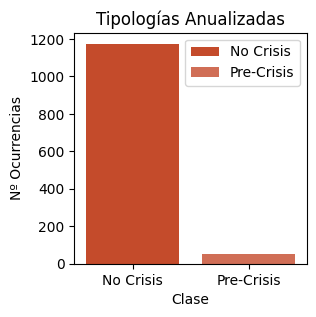

In [16]:
fig,ax = plt.subplots(figsize=(3,3))
ax = sns.countplot(data, x='crisisJST', palette=sns.color_palette(viu_colors,2)).set(title='Tipologías Anualizadas')
plt.xlabel('Clase')
plt.ylabel('Nº Ocurrencias')
plt.xticks(ticks=[0,1],labels=etiquetas)
plt.legend(etiquetas)
plt.savefig('../app/graficas/comprension_final_instancias_clase.png', bbox_inches='tight')
plt.show()

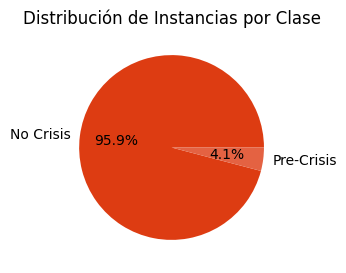

In [17]:
fig,ax = plt.subplots(figsize=(3,3))
aggregates = data['crisisJST'].value_counts()
plt.pie(aggregates, labels = etiquetas, colors=sns.color_palette(viu_colors, 2), autopct='%.1f%%')
plt.title('Distribución de Instancias por Clase')
plt.savefig('../app/graficas/comprension_final_porcentaje_clase.png', bbox_inches='tight')
plt.show()

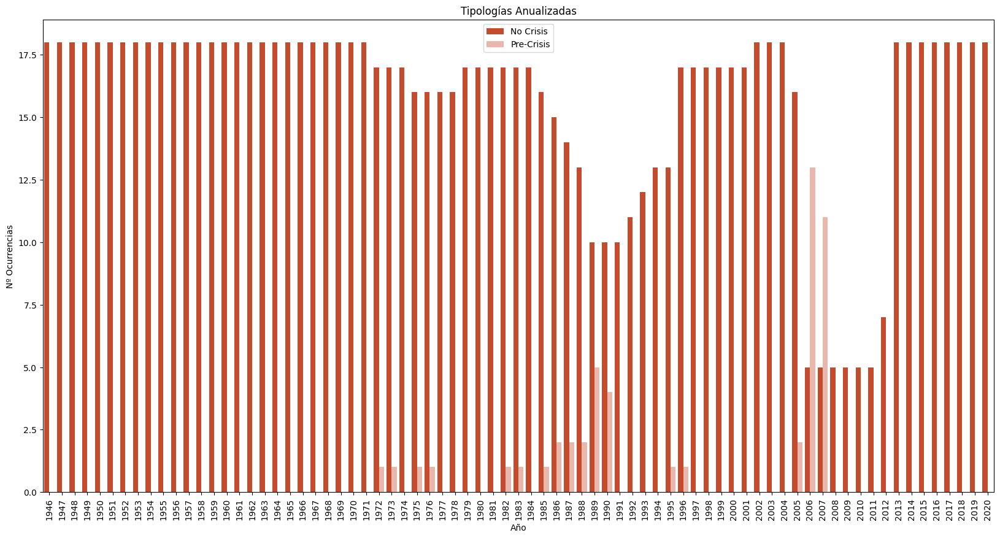

In [18]:
fig,ax = plt.subplots(figsize=(20,10))
ax = sns.countplot(data[['year', 'crisisJST']], x='year', hue='crisisJST', palette=sns.color_palette(['#dd3c12', '#f3b1a1'])).set(title='Tipologías Anualizadas')
plt.xlabel('Año')
plt.ylabel('Nº Ocurrencias')
plt.xticks(rotation=90)
plt.legend(etiquetas)
plt.savefig('../app/graficas/comprension_final_tipologias_anualizadas.png', bbox_inches='tight')
plt.show()

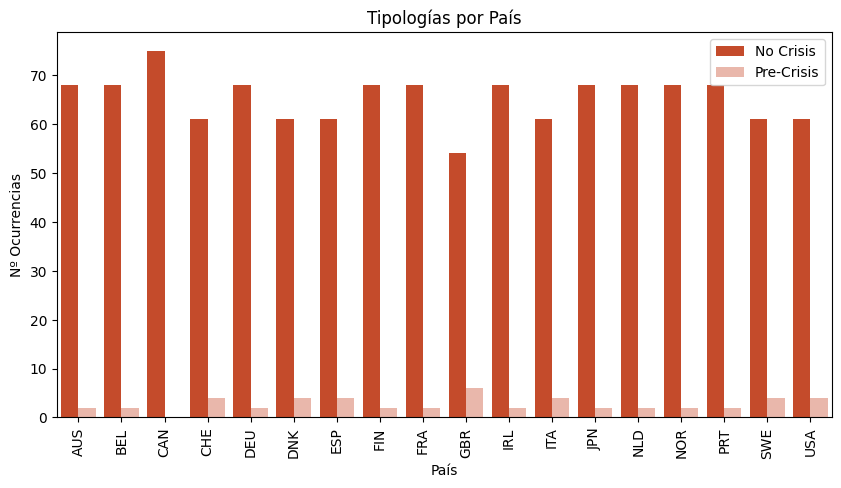

In [19]:
fig,ax = plt.subplots(figsize=(10,5))
ax = sns.countplot(data[['iso', 'crisisJST']], x='iso', hue='crisisJST', palette=sns.color_palette(['#dd3c12', '#f3b1a1'])).set(title='Tipologías por País')
plt.xlabel('País')
plt.ylabel('Nº Ocurrencias')
plt.xticks(rotation=90)
plt.legend(etiquetas)
plt.savefig('../app/graficas/comprension_final_tipologias_pais.png', bbox_inches='tight')
plt.show()

In [20]:
# Revisamos la distribución de los valores ausentes
num_ausentes = data.isna().sum()
porcentaje = round(num_ausentes / data.shape[0] * 100, 2)
porcentaje.sort_values(ascending=False, inplace=True)
porcentaje_med = round(np.sum(porcentaje) / porcentaje.shape[0], 2)
print(f'Porcentaje Medio de Valores Ausentes: {porcentaje_med}%\n')
print('Porcentaje de Valores Ausentes por Columna')
print(porcentaje)

Porcentaje Medio de Valores Ausentes: 1.23%

Porcentaje de Valores Ausentes por Columna
money_pib_dif_abs2       3.51
pdebt_pib_dif_abs2       3.10
inv_pib_dif_abs2         2.53
tdbtserv_pib_dif_abs2    2.45
ca_pib_dif_abs2          2.04
tloans_pib_dif_abs2      1.88
drate                    1.63
rconsbarro_dif_por2      0.08
cpi_dif_por2             0.00
global_loan2             0.00
global_drate             0.00
year                     0.00
iso                      0.00
crisisJST                0.00
dtype: float64


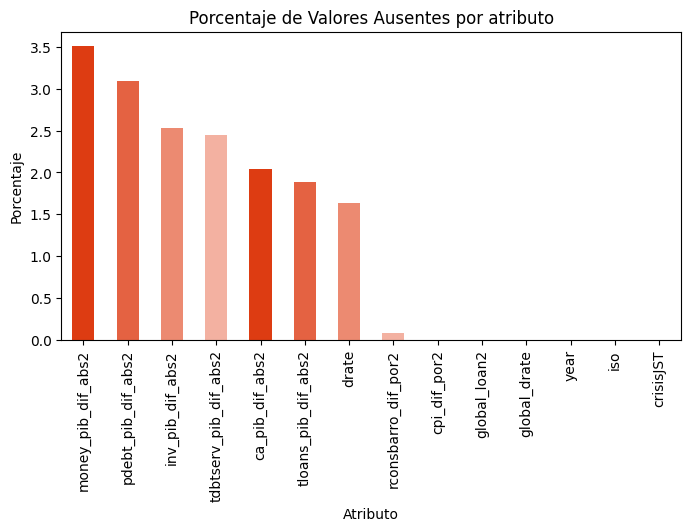

In [21]:
porcentaje.plot(kind="bar", figsize=(8,4), color=viu_colors).set(title='Porcentaje de Valores Ausentes por atributo')
plt.xlabel('Atributo')
plt.ylabel('Porcentaje')
plt.xticks(rotation=90)
plt.savefig('../app/graficas/comprension_final_porcentaje_ausentes_atributo.png', bbox_inches='tight')
plt.show()

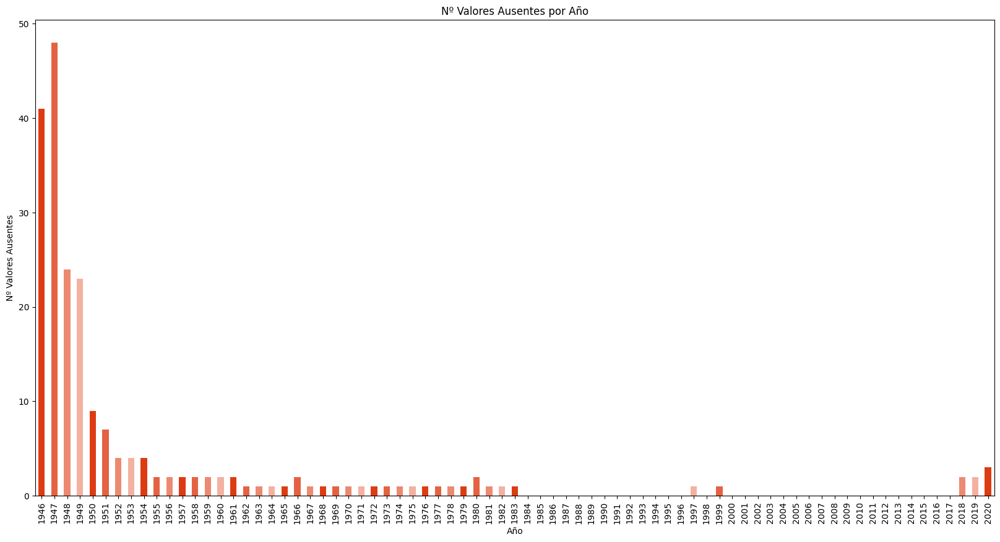

In [22]:
agrupacion = data.groupby('year').apply(lambda x: (x.isnull().sum(axis=1)).sum())

agrupacion.plot(kind="bar", stacked=True, rot=90, figsize=(20,10), xlabel='Año', title='Nº Valores Ausentes por Año',
             color=viu_colors)
plt.ylabel('Nº Valores Ausentes')
plt.savefig('../app/graficas/comprension_final_ausentes_anio.png', bbox_inches='tight')
plt.show()

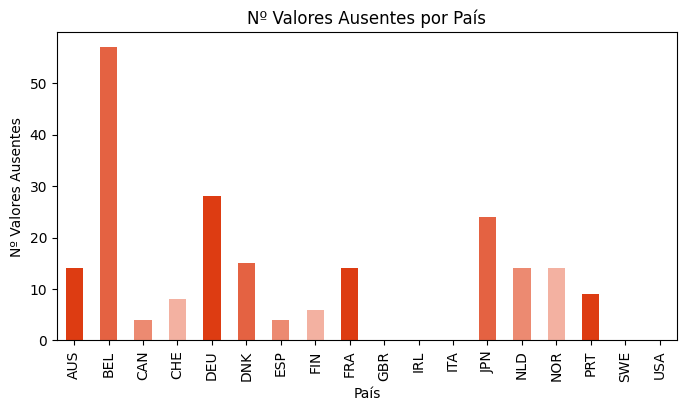

In [23]:
agrupacion = data.groupby('iso').apply(lambda x: (x.isnull().sum(axis=1)).sum())

agrupacion.plot(kind="bar", stacked=True, rot=90, figsize=(8,4), xlabel='País', title='Nº Valores Ausentes por País',
             color=viu_colors)
plt.ylabel('Nº Valores Ausentes')
plt.savefig('../app/graficas/comprension_final_ausentes_pais.png', bbox_inches='tight')
plt.show()

# Distribución de valores de atributos por país

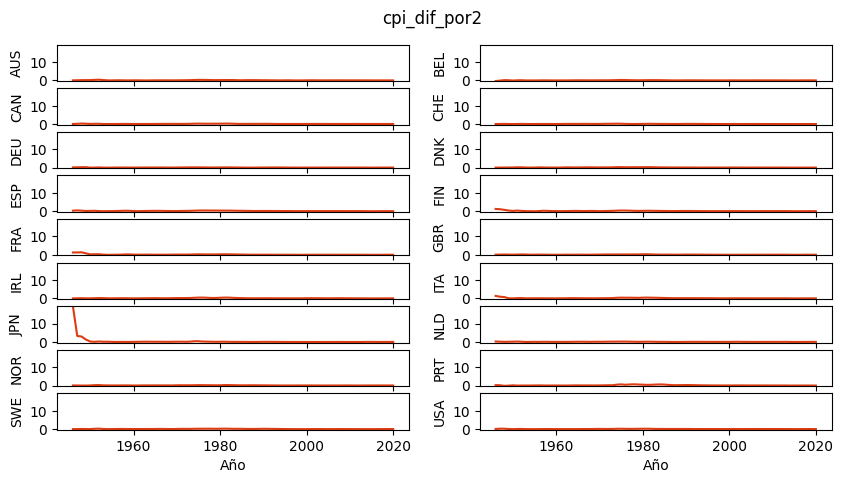

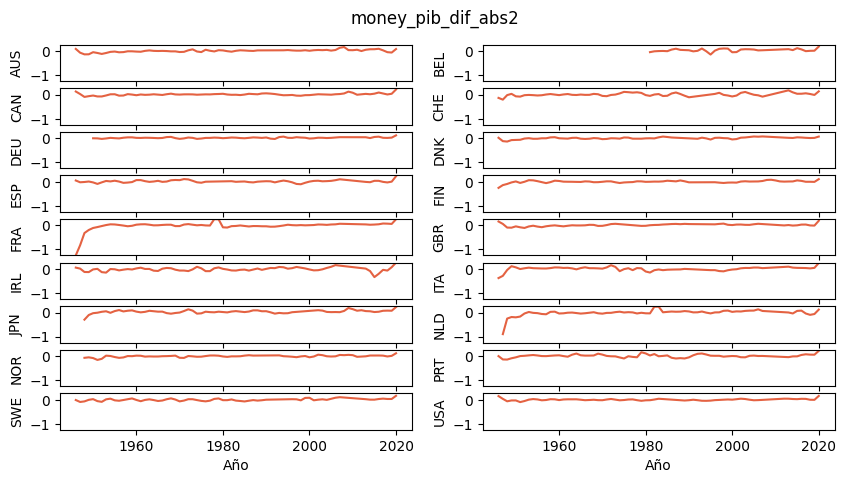

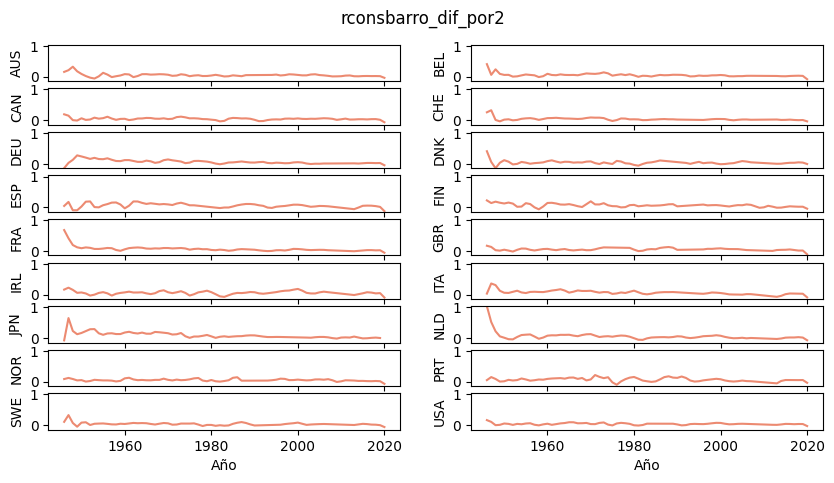

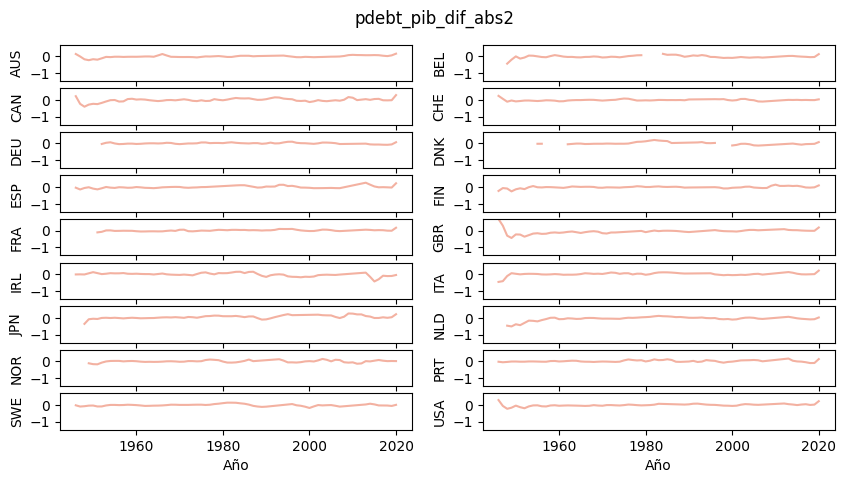

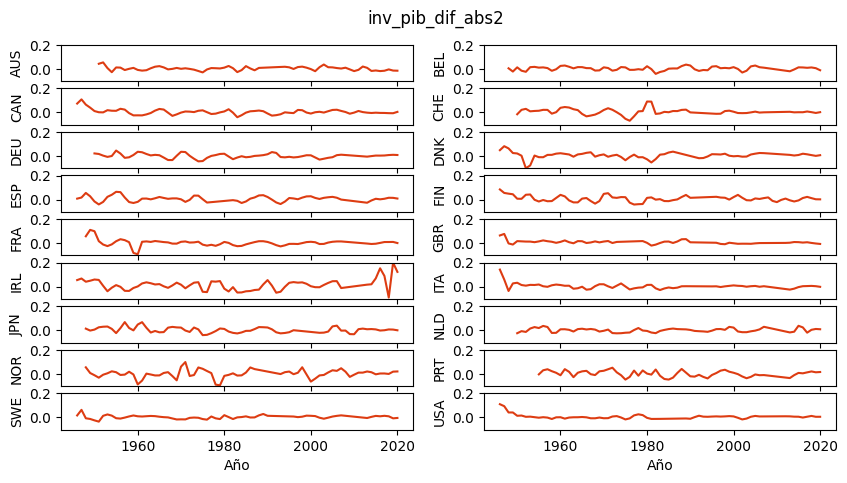

...

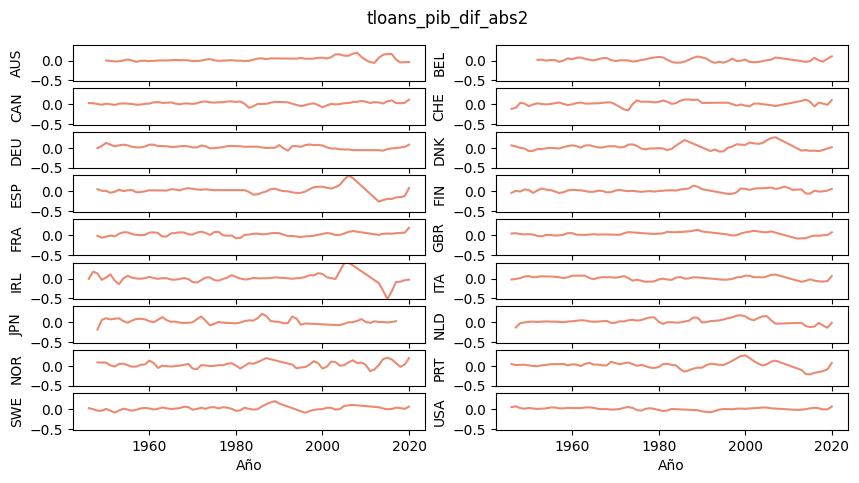

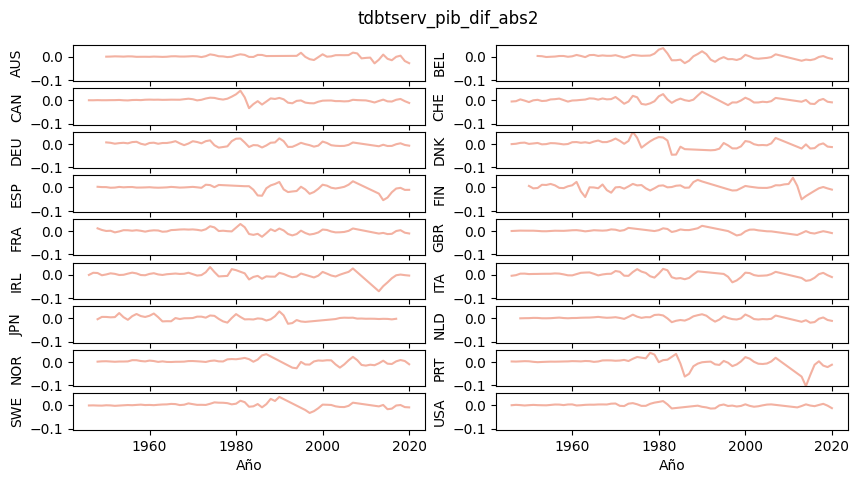

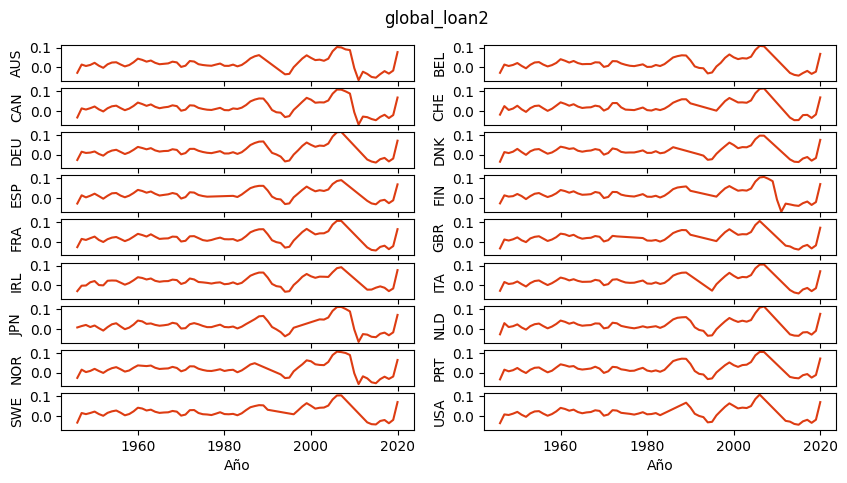

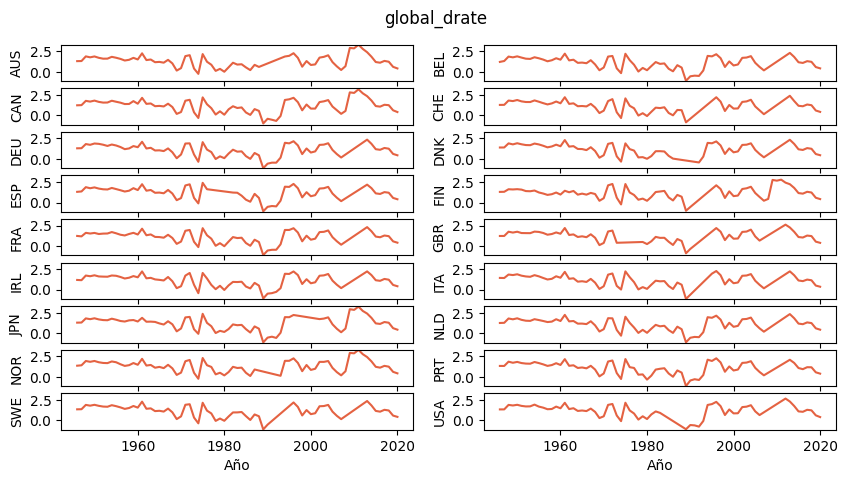

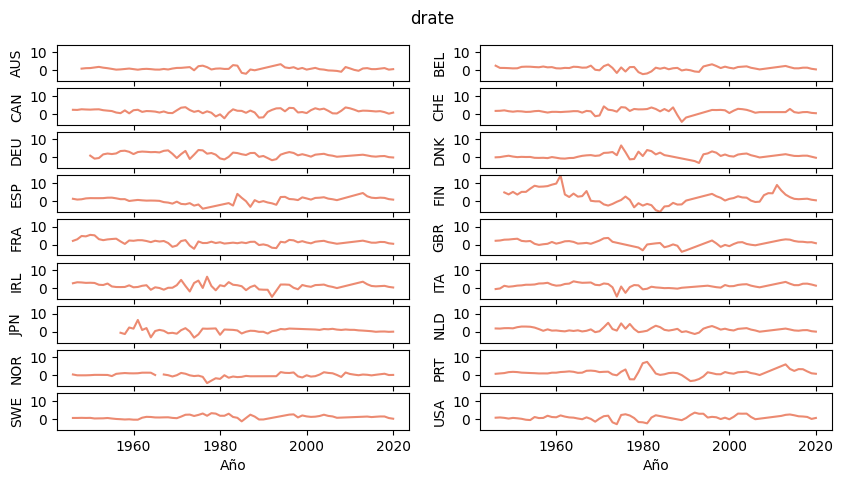

In [24]:
isos = list(data['iso'].unique())
columnas = data.columns

for i in range(data.shape[1]-3):
    fig, ax = plt.subplots(int(len(isos)/2), 2, sharex=True, figsize=(10, 5))
    contador = 0
    for j in range(int(len(isos)/2)):
        for k in range(2):
                ax[j,k].plot(data[data['iso'] == isos[contador]]['year'], data[data['iso'] == isos[contador]][columnas[i]], label=isos[contador], color=viu_colors[i]) 
                ax[j,k].set_ylabel(isos[contador], rotation=90)
                ax[j,k].set_ylim(data[columnas[i]].min(), data[columnas[i]].max())
                contador += 1
                ax[j,k].set_xlabel('Año')
    plt.suptitle(columnas[i], y=0.95)
    plt.savefig('../app/graficas/comprension_final_valores_atributos_pais_' + str(i) + '.png', bbox_inches='tight')
    plt.show()
    

# Distribución de valores de atributos por clase

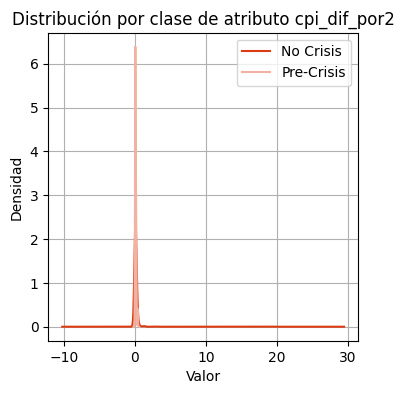

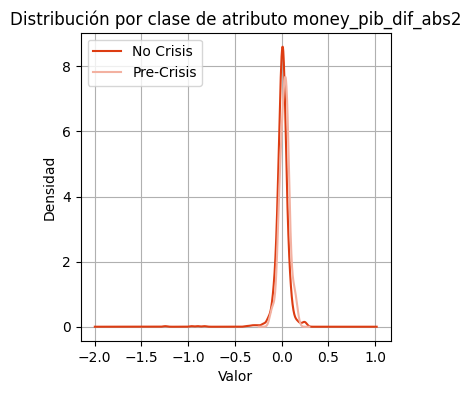

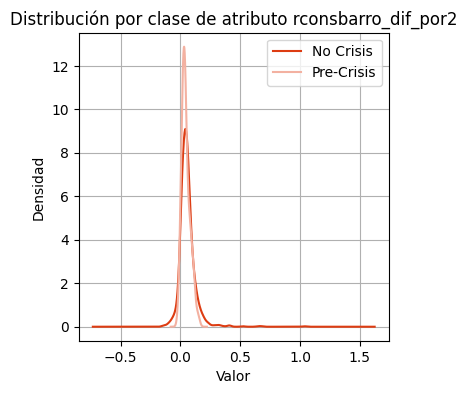

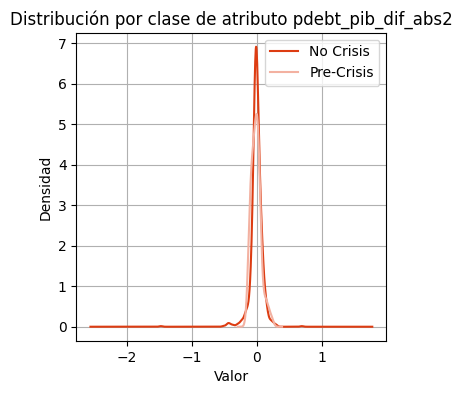

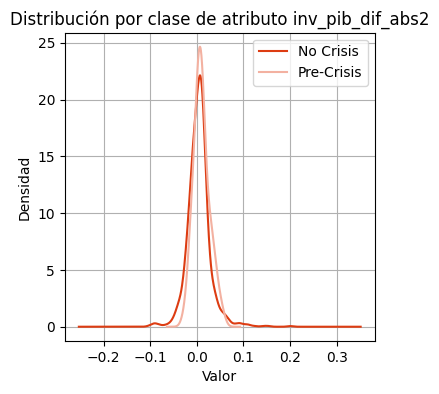

...

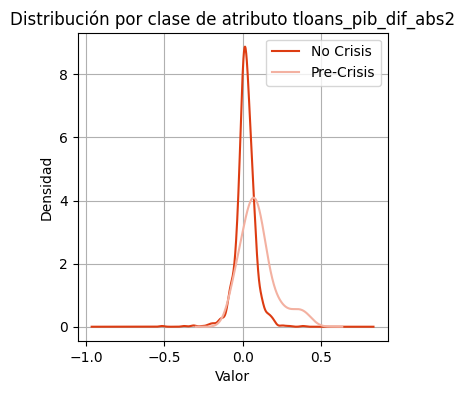

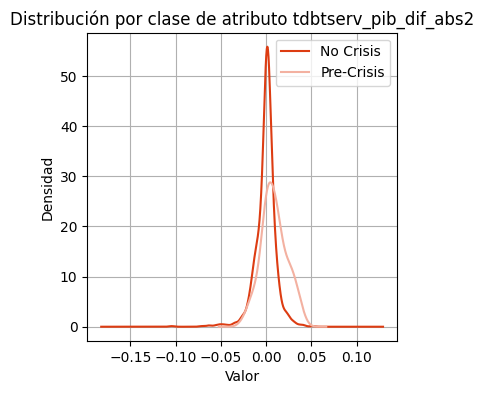

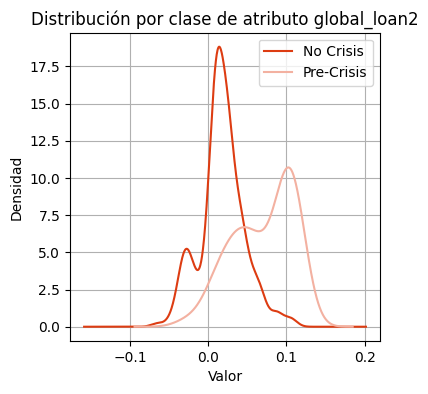

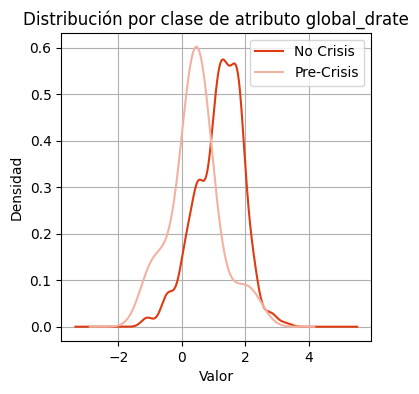

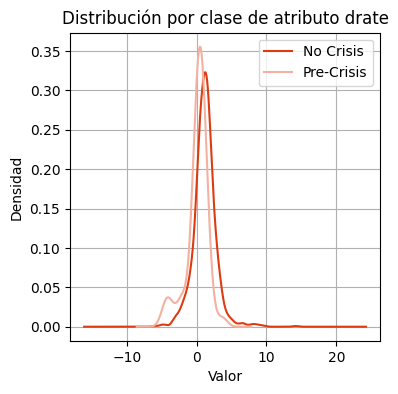

In [25]:
plt.rcParams['axes.prop_cycle'] = plt.cycler(color=['#dd3c12', '#f3b1a1'])
for i in range(data.shape[1]-3):
    f, ax = plt.subplots()
    data.groupby("crisisJST")[columnas[i]].plot.kde(ax=ax, figsize=(4,4))
    ax.set_ylabel('Densidad')
    ax.set_xlabel('Valor')
    plt.legend(etiquetas)
    plt.title('Distribución por clase de atributo ' + columnas[i])
    plt.grid()
    plt.savefig('../app/graficas/comprension_final_distribucion_atributos_clase_' + str(i) + '.png', bbox_inches='tight')
    plt.show()

In [26]:
# f, ax = plt.subplots(11,1,2)

# for i in range(data.shape[1]-3):
    
#     data[data['crisisJST']==0].plot.barh(ax=ax[i,1,0])
#     # data.groupby("crisisJST")[columnas[i]].plot.hist(ax=ax)
#     data[data['crisisJST']==1].plot.barh(ax=ax[i,1,1])
#     ax[i,1,0].set_ylabel('Densidad')
#     plt.legend(['No Crisis', 'Pre-Crisis'])
#     plt.grid()
#     plt.show()

In [27]:
# fig, ax = plt.subplots(data.shape[1]-3), 1, figsize=(10, 5))
# for i in range(data.shape[1]-3):
#     plt.scatter(data.index, data[columnas[i]], c=data['crisisJST'], cmap=viu_cmap) 
#     plt.show()

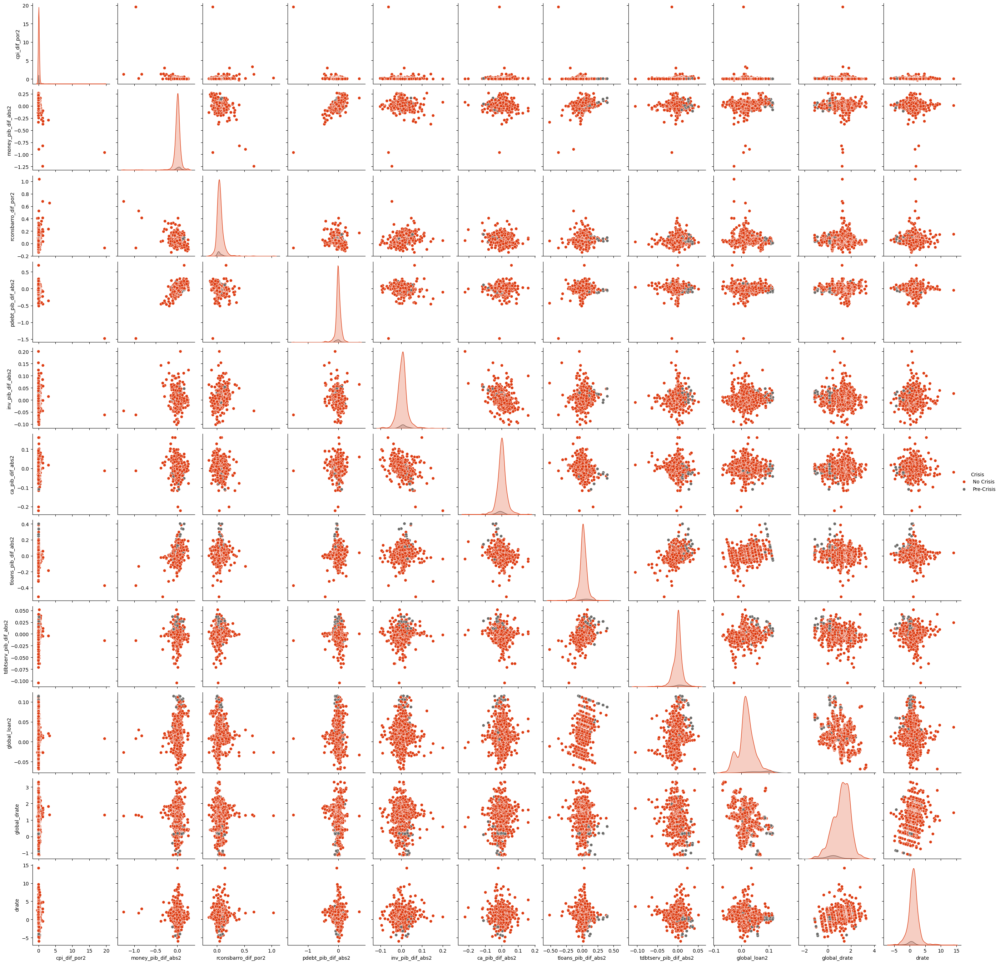

In [28]:
scatter_colors = ['#dd3c12', '#6b6b69']
grafico = sns.pairplot(data.loc[:, ~data.columns.isin(['year', 'iso'])], hue='crisisJST', palette=sns.color_palette(scatter_colors))
grafico._legend.set_title("Crisis")
for i, j in zip(grafico._legend.texts, etiquetas): i.set_text(j)
plt.savefig('../app/graficas/comprension_final_pairplot.png', bbox_inches='tight')
plt.show()

In [29]:
# from mpl_toolkits import mplot3d
# fig = plt.figure(figsize = (10, 7))
# ax = plt.axes(projection ="3d")
# ax.scatter3D(data['cpi_dif_por2'], data['ca_pib_dif_abs2'], data['drate'], c=data['crisisJST'], cmap='jet')
# plt.title("3D scatter")
# plt.show()

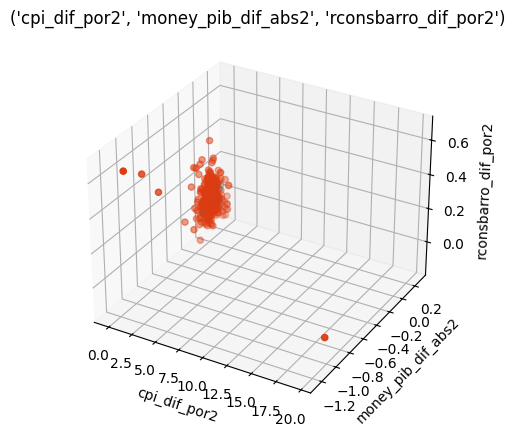

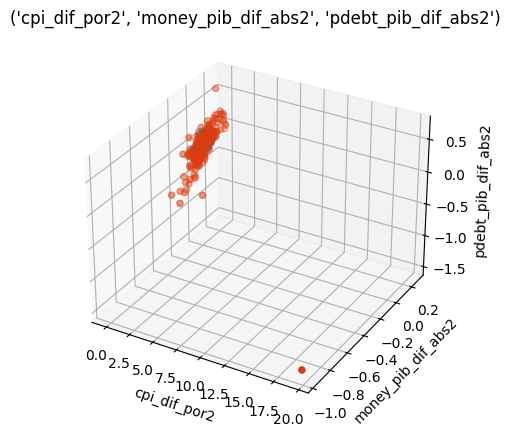

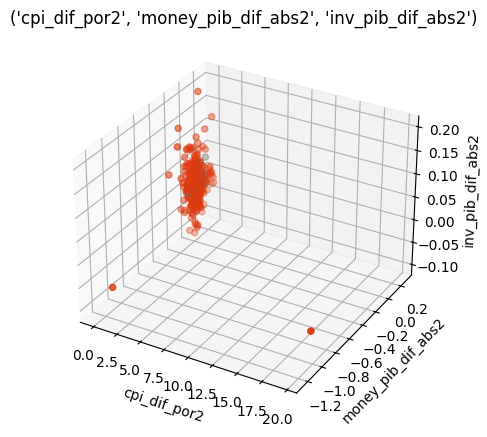

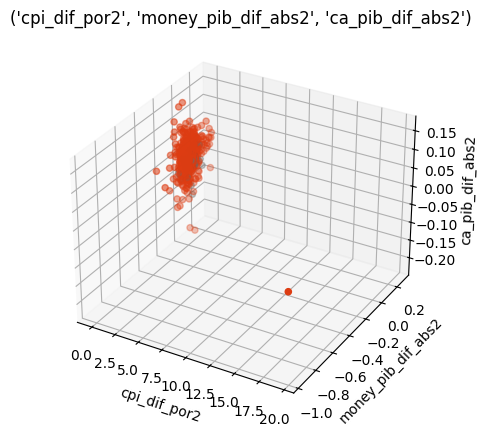

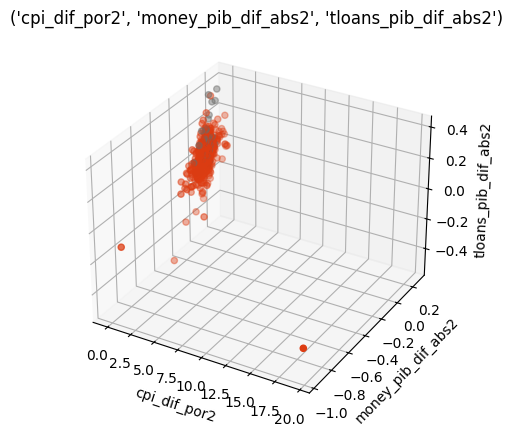

...

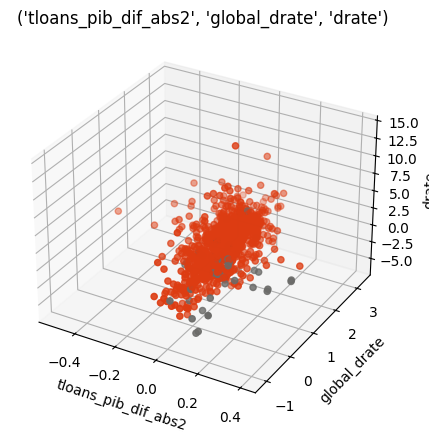

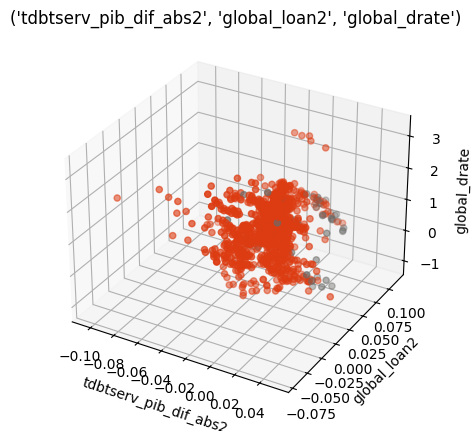

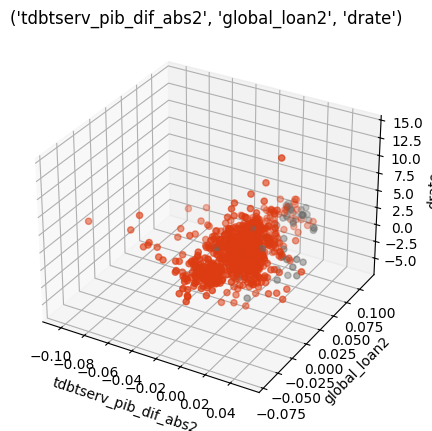

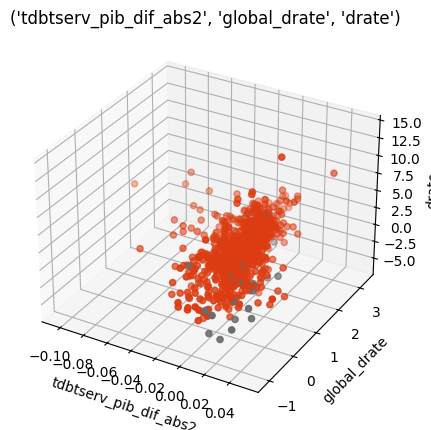

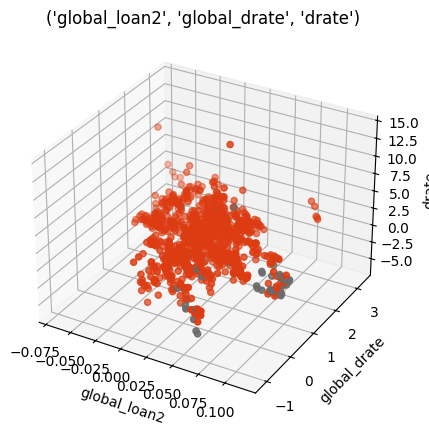

In [30]:
import itertools
from matplotlib.colors import ListedColormap

viu_cmap = ListedColormap(['#dd3c12', '#6b6b69'], name='viu_cmap')
combinaciones = itertools.combinations(columnas[:-3], 3)

for combinacion in combinaciones:    
    fig = plt.figure(figsize = (8, 5))
    ax = plt.axes(projection ="3d")
    ax.scatter3D(data[combinacion[0]], data[combinacion[1]], data[combinacion[2]], c=data['crisisJST'], cmap=viu_cmap)
    plt.title(combinacion)
    ax.set_xlabel(combinacion[0])
    ax.set_ylabel(combinacion[1])
    ax.set_zlabel(combinacion[2])
    plt.show()

## Guardamos el dataset creado

In [31]:
import os
if not os.path.exists('../datasets/finales'):
    os.mkdir('../datasets/finales')

data.to_csv('../datasets/finales/data_final.csv', sep=';', na_rep='', decimal=',', index=False)